In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import torch
import numpy as np
from torch import cuda
from torchvision import datasets, transforms
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import IterableDataset
import torchvision.utils as vutils
import matplotlib.animation as animation
from IPython.display import HTML
import os
# from torchgan.layers import VirtualBatchNorm

torch.manual_seed(42)

In [2]:
print(torch.__version__)
from torch import cuda
print(cuda.get_device_name(cuda.current_device()))

1.13.0
NVIDIA TITAN X (Pascal)


# Data

In [3]:
%cd /home/root2
!ls

/home/root2
AdvSemiSeg				Notebooks   save
CCT					data	    tmux-client-32898.log
Miniconda3-py37_4.12.0-Linux-x86_64.sh	miniconda3  tmux-server-32900.log


In [4]:
transform=transforms.Compose([
        # Pad images with 0s
        transforms.Pad((0,4,4,0), fill=0, padding_mode='constant'),
        transforms.ToTensor(), # Make all pixel value between [0, 1]
        transforms.Normalize((0.5), (0.5)),
        ])

# Download or load train data
dataset_full = datasets.MNIST('./data', train=True, download=True, transform=transform)

# Split train and val data
valid_size = 5000
train_size = len(dataset_full) - 5000
dataset_train, dataset_valid = torch.utils.data.random_split(dataset_full, [train_size, valid_size])

# Download or load test data
dataset_test = datasets.MNIST('./data', train=False,
                   transform=transform)

# Create dataloader
train_kwargs = {'batch_size': 128, 'shuffle': True}
valid_kwargs = {'batch_size': 128, 'shuffle': False}
test_kwargs = {'batch_size': 128, 'shuffle': False}

train_loader = DataLoader(dataset_train, **train_kwargs)
valid_loader = DataLoader(dataset_valid, **valid_kwargs)
test_loader = DataLoader(dataset_test, **test_kwargs)

In [5]:
dataset_full

Dataset MNIST
    Number of datapoints: 60000
    Root location: ./data
    Split: Train
    StandardTransform
Transform: Compose(
               Pad(padding=(0, 4, 4, 0), fill=0, padding_mode=constant)
               ToTensor()
               Normalize(mean=0.5, std=0.5)
           )

In [6]:
# datatset_train: [(tensor_image, int_label), ...]
print("Image Shape: {}".format(dataset_train[0][0].shape))
print()
print("Training Set:   {} samples".format(len(dataset_train)))
print("Validation Set:   {} samples".format(len(dataset_valid)))
print("Test Set:       {} samples".format(len(dataset_test)))

Image Shape: torch.Size([1, 32, 32])

Training Set:   55000 samples
Validation Set:   5000 samples
Test Set:       10000 samples


# Model

In [7]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
    elif classname.find('VirtualBatchNorm') != -1:
        nn.init.normal_(m.gamma.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [8]:
import torch.nn as nn

class VirtualBatchNorm(nn.Module):
    def __init__(self, in_features, eps=1e-5):
        super(VirtualBatchNorm, self).__init__()
        self.in_features = in_features
        shape = (1, in_features, 1, 1)
        self.gamma = nn.Parameter(torch.ones(shape))
        self.bias = nn.Parameter(torch.zeros(shape))
        self.ref_mean = None
        self.ref_mean_sq = None
        self.ref_n = None
        self.eps = eps

    def _batch_stats(self, x):
        mean = x.mean(dim=(0, 2, 3), keepdim=True) 
        mean_sq = (x ** 2).mean(dim=(0, 2, 3), keepdim=True)
        
        return mean, mean_sq

    def _normalize(self, x, mean, mean_sq):
        var = (mean_sq - mean**2)
        x = (x - mean) / torch.sqrt(var + self.eps)
        return x * self.gamma + self.bias

    def forward(self, x):
        assert x.size(1) == self.in_features
        if self.ref_mean is None or self.ref_mean_sq is None or self.ref_n is None:
            ref_mean, ref_mean_sq = self._batch_stats(x)
            self.ref_mean = ref_mean.clone().detach() # (1,C,1,1)
            self.ref_mean_sq = ref_mean_sq.clone().detach() # (1,C,1,1)
            self.ref_n = float(x.shape[0]) # int
            out = self._normalize(x, self.ref_mean, self.ref_mean_sq)
            
        else:
            new_coeff = 1. / (self.ref_n + 1.)
            old_coeff = 1. - new_coeff
            mean = new_coeff * x + old_coeff * self.ref_mean
            mean_sq = new_coeff * (x**2) + old_coeff * self.ref_mean_sq
            out = self._normalize(x, mean, mean_sq)
        return out


In [9]:
from torch import nn, optim
import torch.nn.functional as F

class UpSample(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UpSample, self).__init__()
        self.up_sample = nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=False),
            VirtualBatchNorm(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.up_sample(x)

class DownSample(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DownSample, self).__init__()
        self.down_sample = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2, inplace=True)
        )

    def forward(self, x):
        return self.down_sample(x)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.project = nn.Linear(100, 4*4*1024, bias=False)
        self.conv_block = nn.Sequential(
#             VirtualBatchNorm(1024),
#             nn.ReLU(inplace=True),
            UpSample(1024, 512),
            UpSample(512, 256),
            UpSample(256, 128),
        )
        self.last_conv = nn.ConvTranspose2d(128, 1, kernel_size=4, stride=2, padding=1, bias=False)

    def forward(self, x):
        out = self.project(x)
        out = out.view(out.shape[0], 1024, 4, 4)
        out = self.conv_block(out)
        out = torch.tanh(self.last_conv(out))
        return out

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(1, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            DownSample(128, 256),
            DownSample(256, 512),
            DownSample(512, 1024),
            DownSample(1024, 2048), # Remove
            nn.Flatten(start_dim=1),
#             nn.Linear(4*4*1024, 1, bias=False),
            nn.Linear(2*2*2048,1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

# Loss

In [10]:
criterion = nn.BCELoss()

# Eval: IS Score

# Training

In [11]:
generator = Generator().cuda()
generator.apply(weights_init)
discriminator = Discriminator().cuda()
discriminator.apply(weights_init)

lr = 2e-4

optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))

num_epochs = 15
best_loss = None
EXP_NAME = 'kiet_base_gan'
if not os.path.isdir(f"./save/{EXP_NAME}"):
    os.makedirs(f"./save/{EXP_NAME}")

PATH = f"./save/{EXP_NAME}/checkpoint.pt"

# print(generator)
# print()
# print(discriminator)

In [12]:
g_losses = []
d_losses = []
iters = 0
img_list = []
img_list_raw = []
fixed_noise = torch.normal(0, 1, size=(64, 1, 100), generator=torch.Generator().manual_seed(999)).cuda()
ref_batch = None

D_x_hist = []
D_Gz_hist = []

for epoch in range(num_epochs):
    g_loss_epoch, d_loss_epoch = [], []
    D_x_epoch, D_Gz_epoch = [], []        
    
    for i, (imgs, labels) in enumerate(train_loader):
#         Save reference label for VBN
#         if epoch == 0 and i == 0: ref_batch = labels
        
        real_imgs = transforms.Resize((64,64))(imgs).cuda()
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        discriminator.zero_grad()
        
        real_out = discriminator(real_imgs)
        CE_labels = torch.full(real_out.shape, 1, dtype=torch.float).cuda()
#         d_loss_real = criterion(real_out, torch.ones(real_out.shape).cuda())
        d_loss_real = criterion(real_out, CE_labels.cuda()) # One-sided label smoothing
        d_loss_real.backward()
        D_x = real_out.mean().item()
        
        ## Train with all-fake batch
        z = torch.normal(0, 1, size=(imgs.shape[0], 1, 100)).cuda()
        fake_imgs = generator(z)
        fake_out = discriminator(fake_imgs.detach())
        d_loss_fake = criterion(fake_out, torch.zeros(fake_out.shape).cuda())
        d_loss_fake.backward()
        D_G_z1 = fake_out.mean().item()
        
        d_loss = d_loss_real + d_loss_fake
        
        optimizer_D.step()
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        generator.zero_grad()

        fake_out = discriminator(fake_imgs)
        g_loss = criterion(fake_out, torch.ones(fake_out.shape).cuda())
        g_loss.backward()
        D_G_z2 = fake_out.mean().item()
        
        optimizer_G.step()
    
        # Save losses
        g_loss_epoch.append(g_loss.item())
        d_loss_epoch.append(d_loss.item())
        
        # Save D
        D_x_epoch.append(D_x)
        D_Gz_epoch.append(D_G_z2)
        
         # Output training stats
        if i % 50 == 0:
            # print result
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i, len(train_loader),
                     d_loss.item(), g_loss.item(), D_x, D_G_z1, D_G_z2))
                      
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 100 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            img_list_raw.append(fake)
            
        iters += 1 
    # Save losses
    g_losses.append(np.array(g_loss_epoch).mean())
    d_losses.append(np.array(d_loss_epoch).mean())
    D_x_hist.append(np.array(D_x_epoch).mean())
    D_Gz_hist.append(np.array(D_Gz_epoch).mean())
        
        

[1/15][0/430]	Loss_D: 1.3688	Loss_G: 2.7945	D(x): 0.5439	D(G(z)): 0.5174 / 0.0671
[1/15][50/430]	Loss_D: 0.7426	Loss_G: 1.6995	D(x): 0.9681	D(G(z)): 0.4194 / 0.2306
[1/15][100/430]	Loss_D: 2.1778	Loss_G: 0.2138	D(x): 0.1464	D(G(z)): 0.0076 / 0.8177
[1/15][150/430]	Loss_D: 1.0107	Loss_G: 1.8651	D(x): 0.4243	D(G(z)): 0.0288 / 0.1875
[1/15][200/430]	Loss_D: 0.3340	Loss_G: 2.6269	D(x): 0.8844	D(G(z)): 0.1798 / 0.0858
[1/15][250/430]	Loss_D: 1.2952	Loss_G: 2.1594	D(x): 0.9121	D(G(z)): 0.6087 / 0.1921
[1/15][300/430]	Loss_D: 0.2557	Loss_G: 2.6976	D(x): 0.8586	D(G(z)): 0.0899 / 0.0822
[1/15][350/430]	Loss_D: 0.5795	Loss_G: 2.4420	D(x): 0.8843	D(G(z)): 0.3566 / 0.0959
[1/15][400/430]	Loss_D: 0.1908	Loss_G: 3.3079	D(x): 0.9257	D(G(z)): 0.1040 / 0.0417
[2/15][0/430]	Loss_D: 1.0920	Loss_G: 0.6178	D(x): 0.3822	D(G(z)): 0.0513 / 0.5632
[2/15][50/430]	Loss_D: 0.1203	Loss_G: 3.4206	D(x): 0.9417	D(G(z)): 0.0557 / 0.0381
[2/15][100/430]	Loss_D: 1.0562	Loss_G: 1.7975	D(x): 0.8809	D(G(z)): 0.5809 / 0.184

[11/15][400/430]	Loss_D: 0.0001	Loss_G: 9.8494	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[12/15][0/430]	Loss_D: 0.0001	Loss_G: 10.2956	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[12/15][50/430]	Loss_D: 0.0002	Loss_G: 9.2022	D(x): 0.9999	D(G(z)): 0.0001 / 0.0001
[12/15][100/430]	Loss_D: 0.0001	Loss_G: 10.0944	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[12/15][150/430]	Loss_D: 0.0001	Loss_G: 9.5890	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[12/15][200/430]	Loss_D: 0.0001	Loss_G: 9.8707	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[12/15][250/430]	Loss_D: 0.0001	Loss_G: 9.8300	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[12/15][300/430]	Loss_D: 0.0001	Loss_G: 10.4198	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[12/15][350/430]	Loss_D: 0.0001	Loss_G: 9.5484	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[12/15][400/430]	Loss_D: 0.0000	Loss_G: 10.6910	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[13/15][0/430]	Loss_D: 0.0001	Loss_G: 10.1489	D(x): 1.0000	D(G(z)): 0.0001 / 0.0001
[13/15][50/430]	Loss_D: 0.0001	Loss_G: 10.1570	D(x): 1.0000	D(G(z

<function matplotlib.pyplot.show(close=None, block=None)>

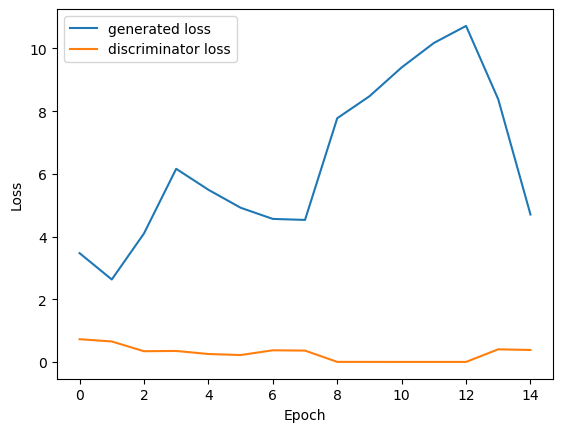

In [13]:
plt.plot(g_losses, label='generated loss')
plt.plot(d_losses, label='discriminator loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show

In [14]:
# torch.save({'loss_d': d_losses,
#             'loss_g': g_losses,
#             'D_x': D_x_hist,
#             'D_G': D_Gz_hist
#             }, "./save/Q1/Q1_VBN.pt")

# Qualitative result

Animation size has reached 21643940 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


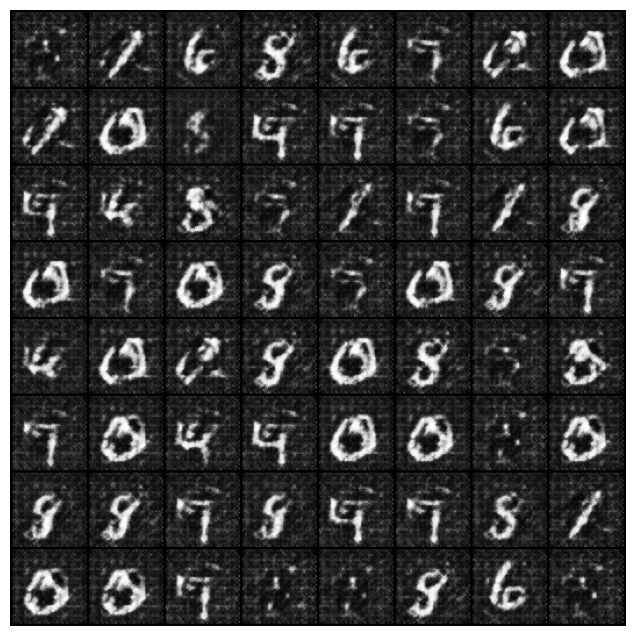

In [15]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

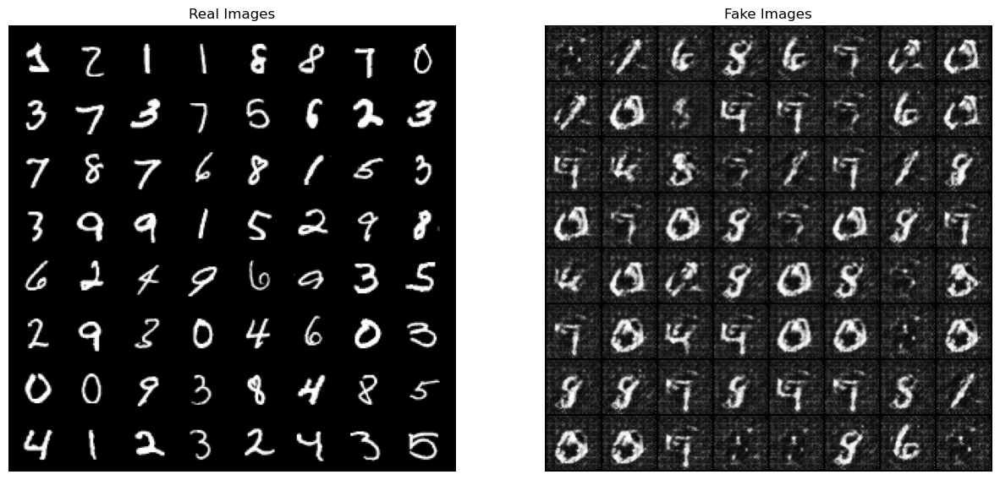

In [16]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].cuda()[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)), cmap='binary')
plt.show()